In [487]:
import random
import copy

import numpy as np
import pandas as pd

from numba import jit, njit, cuda, prange

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

import plotly.express as px

# N-2D Self Avoiding Random Walkers

In [266]:
grid_size = int(1e4)
max_steps = int(3e4)
walkers = int(3e3)

if (grid_size % 2) == 0:
    grid_size += 1

In [268]:
random_walks = []

for j in range(walkers):

    grid = np.zeros((grid_size, grid_size))

    grid[0, :] = 1
    grid[-1, :] = 1
    grid[:, 0] = 1
    grid[:, -1] = 1
    
    grid[int(grid_size/2), int(grid_size/2)] = True

    x, y = int(grid_size/2), int(grid_size/2)
    idx, idy = copy.copy(x), copy.copy(y)
    
    X = [x]
    Y = [y]
    T = [0]

    for i in range(max_steps):
        
        if((grid[idx+1, idy+1] == 1) & (grid[idx-1, idy-1] == 1) & (grid[idx-1, idy+1] == 1) & (grid[idx+1, idy-1] == 1)):
            break
        
        while grid[idx, idy] == 1:
            idx, idy = copy.copy(x), copy.copy(y)
    
            X_rand = random.uniform(0, 1) - 0.5
            X_rand /= abs(X_rand)
            idx += int(X_rand)
        
            Y_rand = random.uniform(0, 1) - 0.5
            Y_rand /= abs(Y_rand)
            idy += int(Y_rand)
    
        x = copy.copy(idx)
        y = copy.copy(idy)
    
        X.append(x)
        Y.append(y)
        T.append(i+1)
    
        grid[x, y] = True

    del grid
    random_walks.append([T, X, Y])

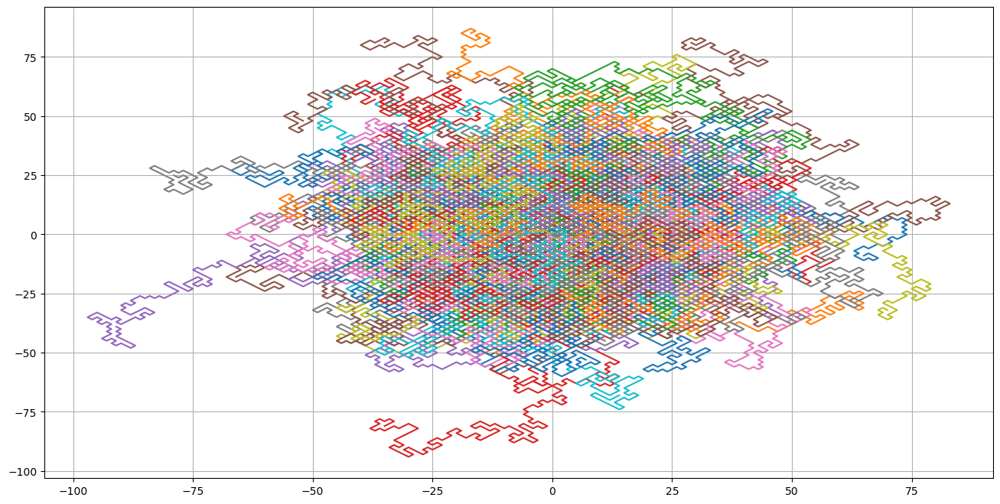

In [269]:
plt.figure(figsize=(16, 8))

for i in range(walkers):
    X = np.array(random_walks[i][1]) - int(grid_size/2)
    Y = np.array(random_walks[i][2]) - int(grid_size/2)
    plt.plot(X, Y)

plt.grid()
plt.show()

# N-3D Self Avoiding Random Walkers

In [539]:
grid_size = int(7e2)
max_steps = int(1e6)
walkers = int(50)

if (grid_size % 2) == 0:
    grid_size += 1

In [541]:
random_walks = []

for j in range(walkers):

    grid = np.zeros((grid_size, grid_size, grid_size))
    
    grid[0] = 1
    grid[-1] = 1
    grid[:, 0, :] = 1
    grid[:, -1, :] = 1
    grid[:, :, 0] = 1
    grid[:, :, -1] = 1
    
    grid[int(grid_size/2), int(grid_size/2), int(grid_size/2)] = True

    x, y, z = int(grid_size/2), int(grid_size/2), int(grid_size/2)
    idx, idy, idz = copy.copy(x), copy.copy(y), copy.copy(z)
    
    X = [x]
    Y = [y]
    Z = [z]
    T = [0]

    for i in range(max_steps):
        
        if(
            (grid[idx+1, idy+1, idz+1] == 1) & 
            (grid[idx+1, idy-1, idz+1] == 1) & 
            (grid[idx+1, idy+1, idz-1] == 1) & 
            (grid[idx-1, idy+1, idz+1] == 1) &
            (grid[idx+1, idy-1, idz-1] == 1) & 
            (grid[idx-1, idy+1, idz-1] == 1) & 
            (grid[idx-1, idy-1, idz+1] == 1) & 
            (grid[idx-1, idy-1, idz-1] == 1)
        ):
            break
        
        while grid[idx, idy, idz] == 1:
            idx, idy, idz = copy.copy(x), copy.copy(y), copy.copy(z)
    
            X_rand = random.uniform(0, 1) - 0.5
            X_rand /= abs(X_rand)
            idx += int(X_rand)
        
            Y_rand = random.uniform(0, 1) - 0.5
            Y_rand /= abs(Y_rand)
            idy += int(Y_rand)

            Z_rand = random.uniform(0, 1) - 0.5
            Z_rand /= abs(Z_rand)
            idz += int(Z_rand)
    
        x = copy.copy(idx)
        y = copy.copy(idy)
        z = copy.copy(idz)
    
        X.append(x)
        Y.append(y)
        Z.append(z)
        T.append(i+1)
    
        grid[x, y, z] = True

    del grid
    random_walks.append([T, X, Y, Z])

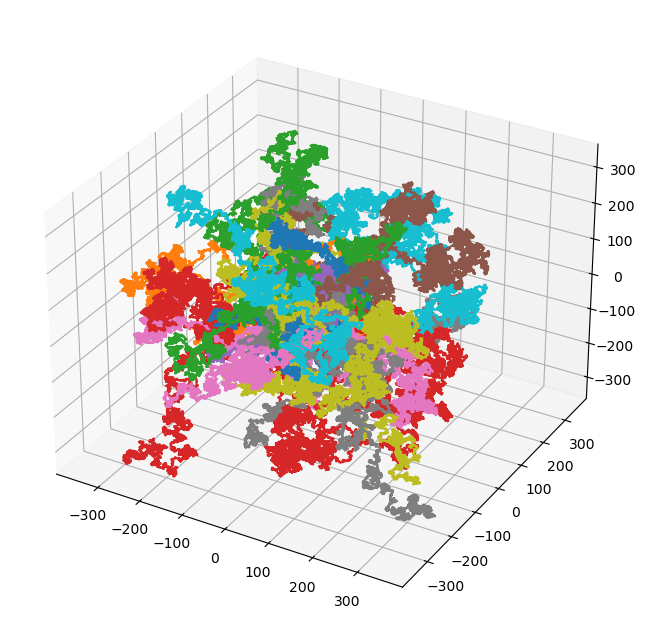

In [547]:
fig = plt.figure(figsize=(16, 8))
ax = fig.add_subplot(111, projection='3d')

for i in range(walkers):
    X = np.array(random_walks[i][1]) - int(grid_size/2)
    Y = np.array(random_walks[i][2]) - int(grid_size/2)
    Z = np.array(random_walks[i][3]) - int(grid_size/2)

    ax.plot(X, Y, Z)

plt.show()

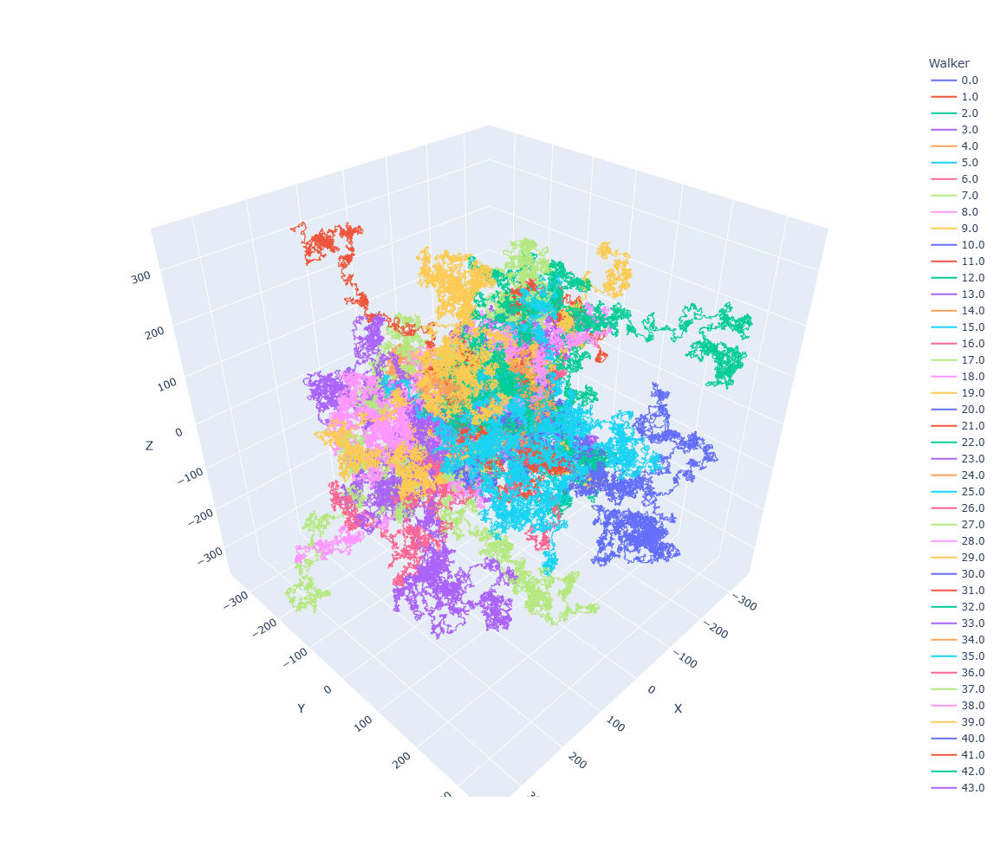

In [543]:
df = pd.DataFrame({"X":[], "Y":[], "Z":[], "Walker":[]})
for i in range(walkers):
    X = np.array(random_walks[i][1]) - int(grid_size/2)
    Y = np.array(random_walks[i][2]) - int(grid_size/2)
    Z = np.array(random_walks[i][3]) - int(grid_size/2)

    df_temporal = pd.DataFrame({"X":X, "Y":Y, "Z":Z, "Walker":i})
    df = pd.concat([df, df_temporal], ignore_index=True)
    
fig = px.line_3d(df, x="X", y="Y", z="Z", color='Walker')

fig.update_layout(
autosize=False,
width=1000,
height=1000,
)
fig.show()